# Data Set Information:

Seven different types of dry beans were used in this research, taking into account the features such as form, shape, type, and structure by the market situation. A computer vision system was developed to distinguish seven different registered varieties of dry beans with similar features in order to obtain uniform seed classification. For the classification model, images of 13,611 grains of 7 different registered dry beans were taken with a high-resolution camera. Bean images obtained by computer vision system were subjected to segmentation and feature extraction stages, and a total of 16 features; 12 dimensions and 4 shape forms, were obtained from the grains.

In [1]:
import numpy as np
import pandas as pd
import pandas_profiling as pp
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler,RobustScaler
from sklearn.cluster import DBSCAN
from plotnine import *
from sklearn.cluster import KMeans
from sklearn.cluster import AgglomerativeClustering
import scipy.cluster.hierarchy as sch
from sklearn.mixture import GaussianMixture
from sklearn.metrics import silhouette_score
from sklearn.decomposition import PCA

In [2]:
df=pd.read_csv(r"D:\ml2\project\test.csv",index_col="ID")

In [3]:
df.head()

,Area,Perimeter,MajorAxisLength,MinorAxisLength,AspectRation,Eccentricity,ConvexArea,EquivDiameter,Extent,Solidity,roundness,Compactness,ShapeFactor1,ShapeFactor2,ShapeFactor3,ShapeFactor4
ID,,,,,,,,,,,,,,,,
10834,57659,955.434,387.757607,196.625782,1.972059,0.861896,60188,270.949661,0.620790,0.957982,0.793735,0.698760,0.006725,0.000989,0.488266,0.962889
10835,28772,630.362,229.990785,159.609367,1.440960,0.719993,29127,191.399185,0.767458,0.987812,0.909913,0.832204,0.007994,0.002365,0.692563,0.997956
10836,54677,911.022,308.853903,226.398571,1.364204,0.680198,55858,263.850182,0.753013,0.978857,0.827860,0.854288,0.005649,0.001856,0.729808,0.995607
10837,24827,578.304,214.192699,147.788172,1.449322,0.723831,25121,177.794033,0.716508,0.988297,0.932871,0.830066,0.008627,0.002526,0.689009,0.998596
10838,141850,1432.847,524.923471,346.910920,1.513136,0.750492,143680,424.981211,0.804617,0.987263,0.868240,0.809606,0.003701,0.000981,0.655462,0.991803


In [4]:
data=df.copy()

# Attribute Information:

* **Area (A)**: The area of a bean zone and the number of pixels within its boundaries.
* **Perimeter (P)**: Bean circumference is defined as the length of its border.
* **Major axis length (L)**: The distance between the ends of the longest line that can be drawn from a bean.
* **Minor axis length (l)**: The longest line that can be drawn from the bean while standing perpendicular to the main axis.
* **Aspect ratio (K)**: Defines the relationship between L and l.
* **Eccentricity (Ec)**: Eccentricity of the ellipse having the same moments as the region.
* **Convex area (C)**: Number of pixels in the smallest convex polygon that can contain the area of a bean seed.
* **Equivalent diameter (Ed)**: The diameter of a circle having the same area as a bean seed area.
* **Extent (Ex)**: The ratio of the pixels in the bounding box to the bean area.
* **Solidity (S)**: Also known as convexity. The ratio of the pixels in the convex shell to those found in beans.
* **Roundness (R)**: Calculated with the following formula: (4piA)/(P^2)
* **Compactness (CO)**: Measures the roundness of an object: Ed/L
* **ShapeFactor1 (SF1)**
* **ShapeFactor2 (SF2)**
* **ShapeFactor3 (SF3)**
* **ShapeFactor4 (SF4)**


# Data exploration

In [5]:
# check the number of columns and rows
print("Data set contains {a} rows and {b} columns".format(a=data.shape[0],b=data.shape[1]))

Data set contains 2709 rows and 16 columns


In [6]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2709 entries, 10834 to 13542
Data columns (total 16 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Area             2709 non-null   int64  
 1   Perimeter        2709 non-null   float64
 2   MajorAxisLength  2709 non-null   float64
 3   MinorAxisLength  2709 non-null   float64
 4   AspectRation     2709 non-null   float64
 5   Eccentricity     2709 non-null   float64
 6   ConvexArea       2709 non-null   int64  
 7   EquivDiameter    2709 non-null   float64
 8   Extent           2709 non-null   float64
 9   Solidity         2709 non-null   float64
 10  roundness        2709 non-null   float64
 11  Compactness      2709 non-null   float64
 12  ShapeFactor1     2709 non-null   float64
 13  ShapeFactor2     2709 non-null   float64
 14  ShapeFactor3     2709 non-null   float64
 15  ShapeFactor4     2709 non-null   float64
dtypes: float64(14), int64(2)
memory usage: 359.8 KB


In [7]:
data.isnull().sum()

Area               0
Perimeter          0
MajorAxisLength    0
MinorAxisLength    0
AspectRation       0
Eccentricity       0
ConvexArea         0
EquivDiameter      0
Extent             0
Solidity           0
roundness          0
Compactness        0
ShapeFactor1       0
ShapeFactor2       0
ShapeFactor3       0
ShapeFactor4       0
dtype: int64

In [8]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
Area,2709.0,52859.636028,28788.904724,20548.000000,36144.000000,44397.000000,61626.000000,231066.000000
Perimeter,2709.0,853.867669,213.681592,524.736000,700.485000,794.894000,979.260000,1845.855000
MajorAxisLength,2709.0,319.333439,85.210636,183.965251,251.623237,297.858034,376.701298,713.967282
MinorAxisLength,2709.0,202.185268,44.809321,122.512653,175.374226,192.367881,216.233028,460.198497
AspectRation,2709.0,1.580199,0.248980,1.036423,1.425448,1.548174,1.706945,2.430306
Eccentricity,2709.0,0.749225,0.093357,0.262774,0.712636,0.763403,0.810425,0.911423
ConvexArea,2709.0,53575.145441,29218.902099,20825.000000,36504.000000,45003.000000,62568.000000,232903.000000
EquivDiameter,2709.0,252.676206,58.813187,161.748342,214.522656,237.756211,280.115441,542.404248
Extent,2709.0,0.749399,0.048909,0.574040,0.718512,0.758598,0.786651,0.842382
Solidity,2709.0,0.987153,0.004745,0.943559,0.985859,0.988277,0.990033,0.994378


In [9]:
pp.ProfileReport(data)

Summarize dataset:   0%|          | 0/31 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [10]:
# This function takes the numerical column as the input and returns the boxplots and histogram 


def histogram_boxplot(feature, figsize=(10,5)):
    """ Boxplot and histogram combined
    feature: 1-d feature array
    figsize: size of fig (default (9,8))
    bins: number of bins (default None / auto)
    """
    f2, (ax_box2, ax_hist2) = plt.subplots(nrows = 2, # Number of rows of the subplot grid= 2
                                           sharex = True, # x-axis will be shared among all subplots
                                           gridspec_kw = {"height_ratios": (.25, .75)}, 
                                           figsize = figsize 
                                           ) # creating the 2 subplots
    sns.boxplot(x=feature, ax=ax_box2,  color='c') # boxplot will be created and a star will indicate the mean value of the column
    sns.histplot(feature, kde=False, ax=ax_hist2) # For histogram
    ax_hist2.axvline(np.mean(feature), color='r', linestyle='--') # Add mean to the histogram
    ax_hist2.axvline(np.median(feature), color='black', linestyle='-') # Add median to the histogram

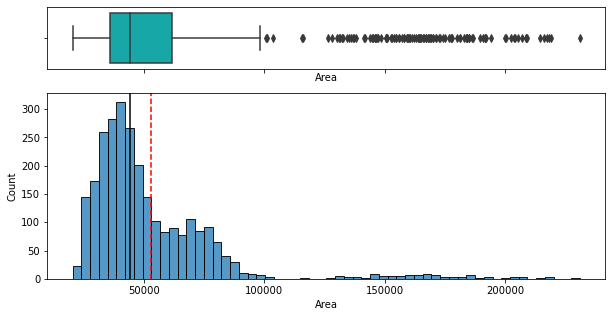

In [11]:
# ditribution of Area
histogram_boxplot(data['Area'])

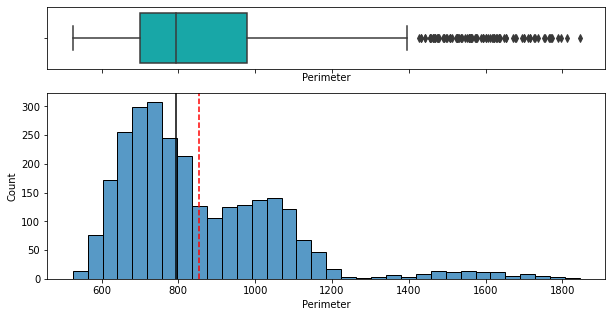

In [12]:
# ditribution of Perimeter
histogram_boxplot(data['Perimeter'])

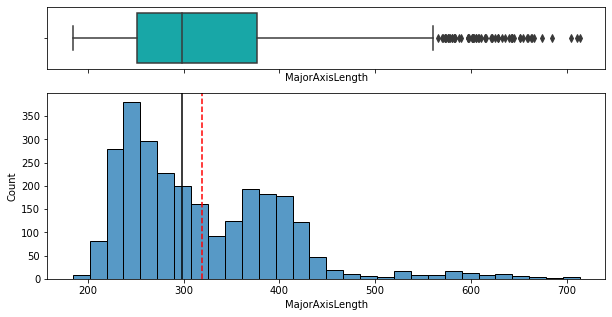

In [13]:
# ditribution of MajorAxisLength
histogram_boxplot(data['MajorAxisLength'])

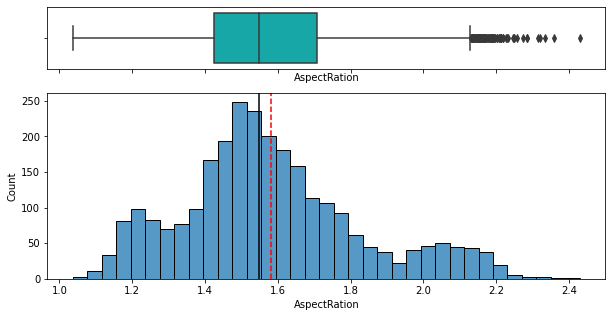

In [14]:
# ditribution of AspectRation
histogram_boxplot(data['AspectRation'])

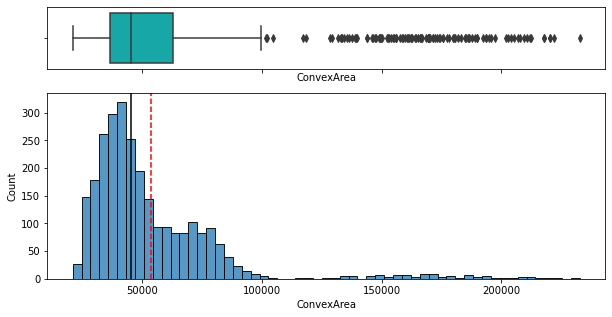

In [15]:
# ditribution of ConvexArea
histogram_boxplot(data['ConvexArea'])

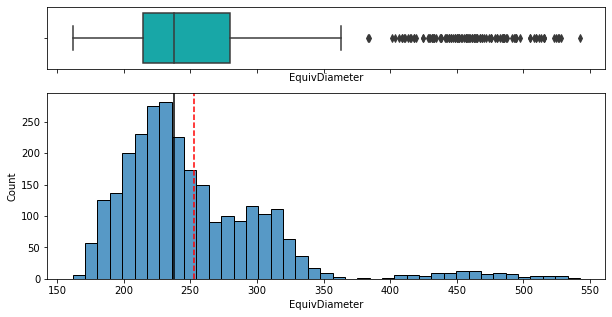

In [16]:
# ditribution of EquivDiameter
histogram_boxplot(data['EquivDiameter'])

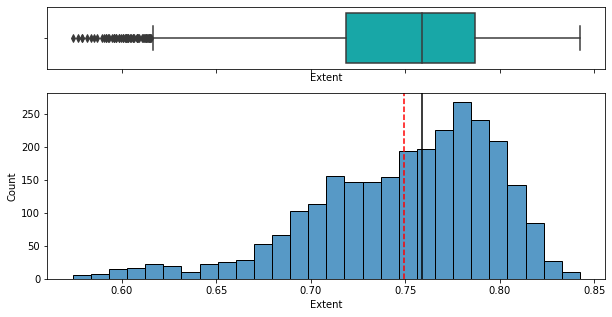

In [17]:
# ditribution of Extent
histogram_boxplot(data['Extent'])

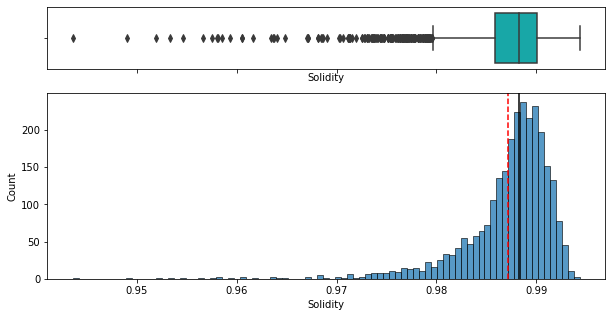

In [18]:
# ditribution of Solidity
histogram_boxplot(data['Solidity'])

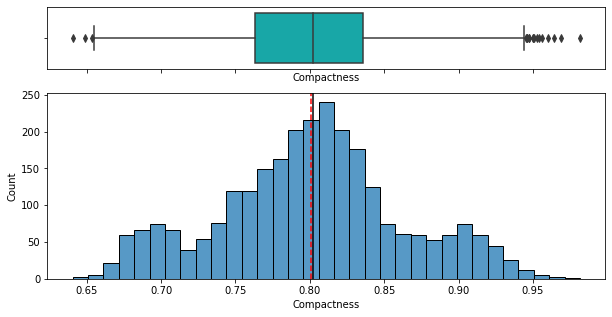

In [19]:
 #ditribution of Compactness
histogram_boxplot(data['Compactness'])

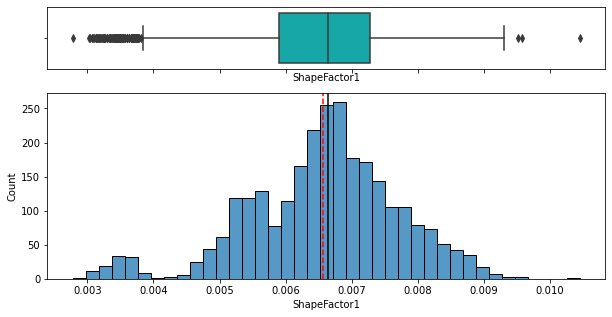

In [20]:
# ditribution of ShapeFactor1
histogram_boxplot(data['ShapeFactor1'])

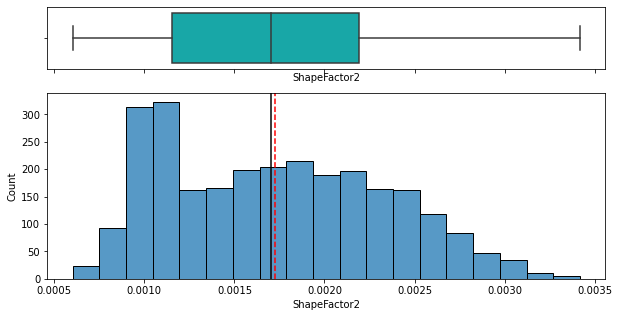

In [21]:
# ditribution of ShapeFactor2
histogram_boxplot(data['ShapeFactor2'])

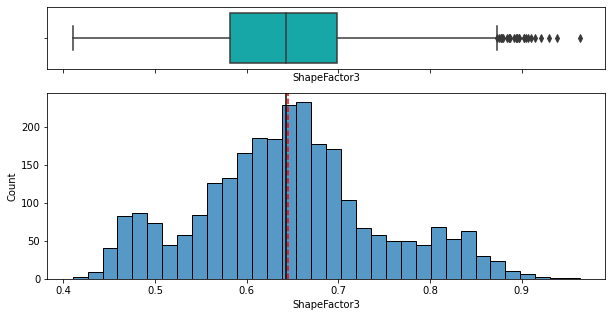

In [22]:
# ditribution of ShapeFactor3
histogram_boxplot(data['ShapeFactor3'])

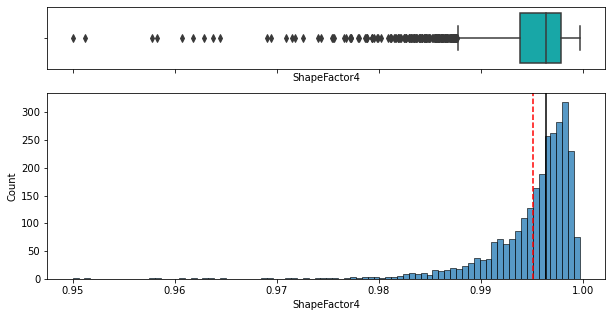

In [23]:
# ditribution of ShapeFactor4
histogram_boxplot(data['ShapeFactor4'])

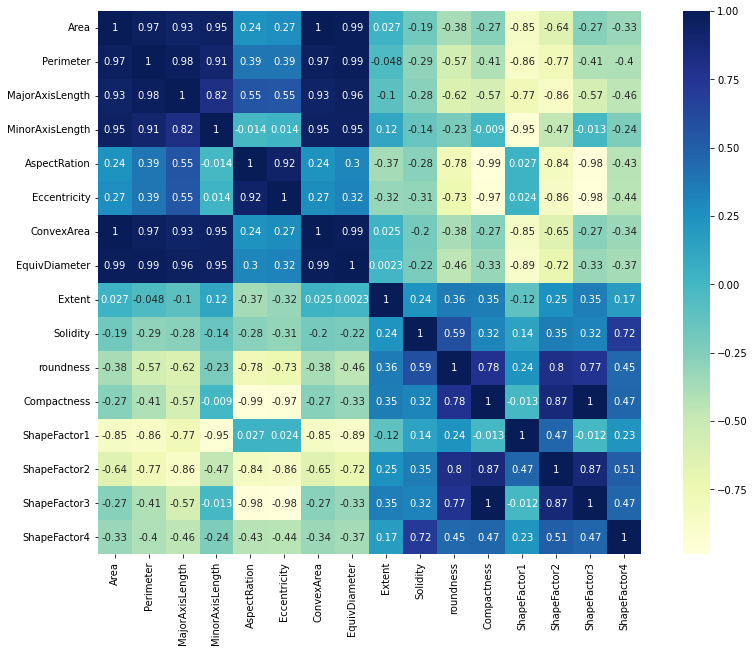

In [24]:
# Apply correlation plot to see the correlation between numerical variables.

plt.figure(figsize=(15,10))
# plt.figure(figsize=(14, 14))
dat_cor = data.corr()
sns.heatmap(dat_cor, cmap = 'YlGnBu', annot=True, square=True);

#  preprocessing for data

In [25]:
data.head()

,Area,Perimeter,MajorAxisLength,MinorAxisLength,AspectRation,Eccentricity,ConvexArea,EquivDiameter,Extent,Solidity,roundness,Compactness,ShapeFactor1,ShapeFactor2,ShapeFactor3,ShapeFactor4
ID,,,,,,,,,,,,,,,,
10834,57659,955.434,387.757607,196.625782,1.972059,0.861896,60188,270.949661,0.620790,0.957982,0.793735,0.698760,0.006725,0.000989,0.488266,0.962889
10835,28772,630.362,229.990785,159.609367,1.440960,0.719993,29127,191.399185,0.767458,0.987812,0.909913,0.832204,0.007994,0.002365,0.692563,0.997956
10836,54677,911.022,308.853903,226.398571,1.364204,0.680198,55858,263.850182,0.753013,0.978857,0.827860,0.854288,0.005649,0.001856,0.729808,0.995607
10837,24827,578.304,214.192699,147.788172,1.449322,0.723831,25121,177.794033,0.716508,0.988297,0.932871,0.830066,0.008627,0.002526,0.689009,0.998596
10838,141850,1432.847,524.923471,346.910920,1.513136,0.750492,143680,424.981211,0.804617,0.987263,0.868240,0.809606,0.003701,0.000981,0.655462,0.991803


In [26]:
sc=RobustScaler()
#sc=StandardScaler()

In [27]:
data_sc = sc.fit_transform(data)

In [28]:
data_sc 

array([[ 0.5204458 ,  0.5758766 ,  0.71874773, ..., -0.68559871,
        -1.33074154, -8.25166584],
       [-0.61317793, -0.59019639, -0.54259915, ...,  0.63993855,
         0.42370892,  0.38667171],
       [ 0.40342202,  0.41656533,  0.08791205, ...,  0.14945439,
         0.74355926, -0.19192141],
       ...,
       [ 0.66042697,  0.7657932 ,  0.88240441, ..., -0.77133498,
        -1.50667182, -9.51829562],
       [-0.39867357, -0.34453233, -0.33602064, ...,  0.33148818,
         0.19617151,  0.21609016],
       [ 0.18750491,  0.12089678,  0.09991177, ..., -0.05365274,
         0.05849931,  0.17495645]])

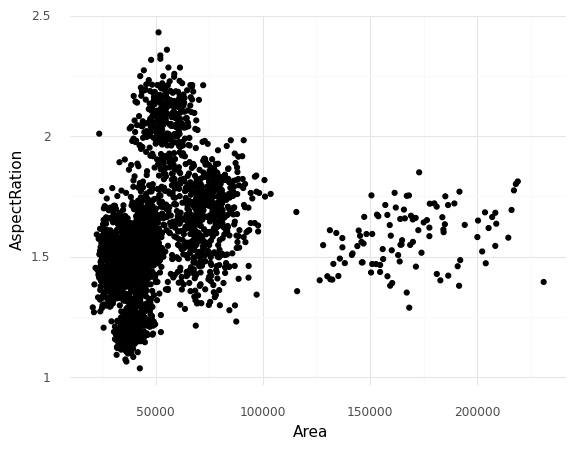

<ggplot: (124135399702)>

In [29]:
ggplot(data, aes(x = 'Area', y = 'AspectRation')) + geom_point() + theme_minimal()

# KMeans

In [30]:
dt1=data.copy()

In [31]:
dt1.head()

,Area,Perimeter,MajorAxisLength,MinorAxisLength,AspectRation,Eccentricity,ConvexArea,EquivDiameter,Extent,Solidity,roundness,Compactness,ShapeFactor1,ShapeFactor2,ShapeFactor3,ShapeFactor4
ID,,,,,,,,,,,,,,,,
10834,57659,955.434,387.757607,196.625782,1.972059,0.861896,60188,270.949661,0.620790,0.957982,0.793735,0.698760,0.006725,0.000989,0.488266,0.962889
10835,28772,630.362,229.990785,159.609367,1.440960,0.719993,29127,191.399185,0.767458,0.987812,0.909913,0.832204,0.007994,0.002365,0.692563,0.997956
10836,54677,911.022,308.853903,226.398571,1.364204,0.680198,55858,263.850182,0.753013,0.978857,0.827860,0.854288,0.005649,0.001856,0.729808,0.995607
10837,24827,578.304,214.192699,147.788172,1.449322,0.723831,25121,177.794033,0.716508,0.988297,0.932871,0.830066,0.008627,0.002526,0.689009,0.998596
10838,141850,1432.847,524.923471,346.910920,1.513136,0.750492,143680,424.981211,0.804617,0.987263,0.868240,0.809606,0.003701,0.000981,0.655462,0.991803


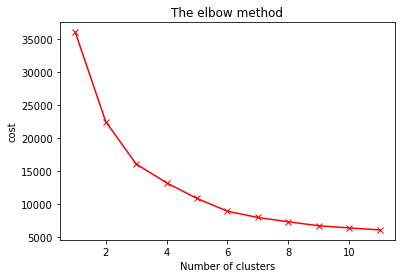

In [32]:
cost=[]

# Finding inertia on various k values
for i in range(1,12):
    kmeans=KMeans(n_clusters = i, init = 'random', 
                    max_iter = 100).fit(data_sc)
    cost.append(kmeans.inertia_)
    
plt.plot(range(1, 12), cost, 'x-', color='red')
plt.title('The elbow method')
plt.xlabel('Number of clusters')
plt.ylabel('cost') 
plt.show()

In [33]:
score = []
for n in range(2,12):
    kmean = KMeans(n_clusters= n )
    kmean.fit(data_sc)
    result = kmean.labels_
    print(n , '    '  , silhouette_score(data_sc , result))

2      0.3889439982229825
3      0.3960665479871222
4      0.3383824046039043
5      0.3535348916382962
6      0.3698251982442372
7      0.31624564977163927
8      0.3155033476911644
9      0.3148755494255001
10      0.2743868059089888
11      0.2679406092569131


In [34]:
kmeans = KMeans(n_clusters=7,init = 'k-means++', max_iter = 100)

y_kmeans = kmeans.fit_predict(data_sc)

In [35]:
kmeans.n_iter_

8

In [36]:
index=kmeans.labels_

In [37]:
index

array([6, 1, 3, ..., 6, 1, 4])

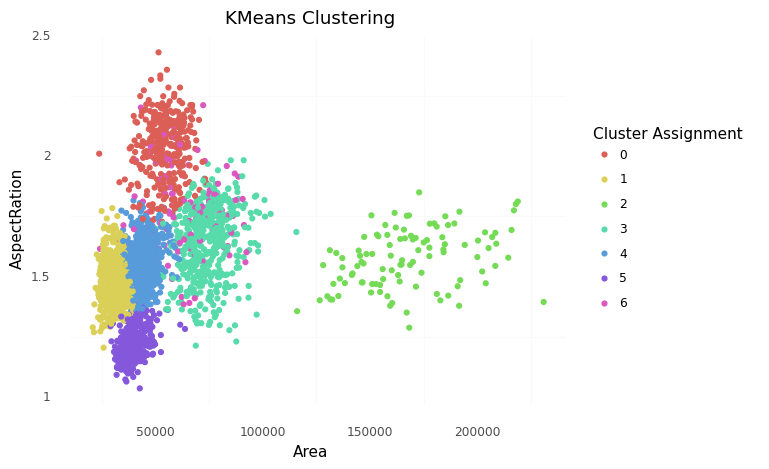

<ggplot: (124144887179)>

In [38]:
dt1["k_labels"] = kmeans.labels_
(ggplot(dt1, aes(x = 'Area', y = 'AspectRation', color = "factor(k_labels)")) +
  geom_point() +
  theme_minimal() +
  scale_color_discrete(name = "Cluster Assignment")+
  theme(panel_grid_major = element_blank()) +
labs(title = "KMeans Clustering"))

In [39]:
print("silhouette_score is equal : ",silhouette_score(data_sc,index))

silhouette_score is equal :  0.316311366155354


# Hierarchical and plot

In [40]:
dt2=data.copy()

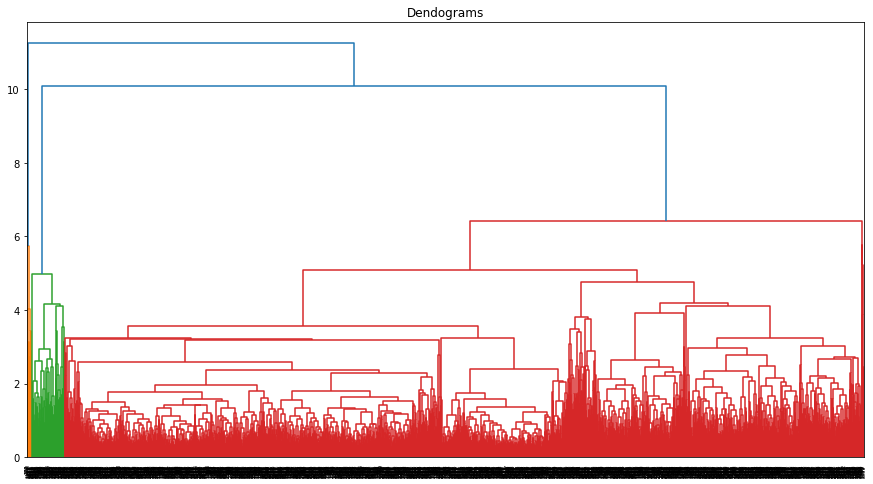

In [41]:
plt.figure(figsize=(15, 8))
plt.title("Dendograms")
dend = sch.dendrogram(sch.linkage(y=data_sc, method='average',metric='euclidean'),orientation='top') 

In [42]:
h1=AgglomerativeClustering(n_clusters=7)

In [43]:
h1.fit(data_sc)

AgglomerativeClustering(n_clusters=7)

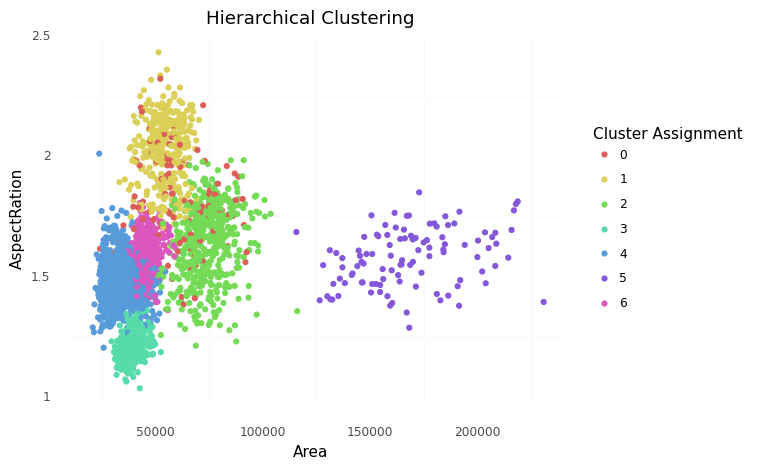

<ggplot: (124114433012)>

In [44]:
dt2["h_labels"] = h1.labels_
(ggplot(dt2, aes(x = 'Area', y = 'AspectRation', color = "factor(h_labels)")) +
  geom_point() +
  theme_minimal() +
  scale_color_discrete(name = "Cluster Assignment")+
  theme(panel_grid_major = element_blank()) +
labs(title = "Hierarchical Clustering"))

In [45]:
print("silhouette_score is equal : ",silhouette_score(data_sc,h1.labels_))

silhouette_score is equal :  0.2675947408058903


# DBscan and plot

In [46]:
dt3=data.copy()

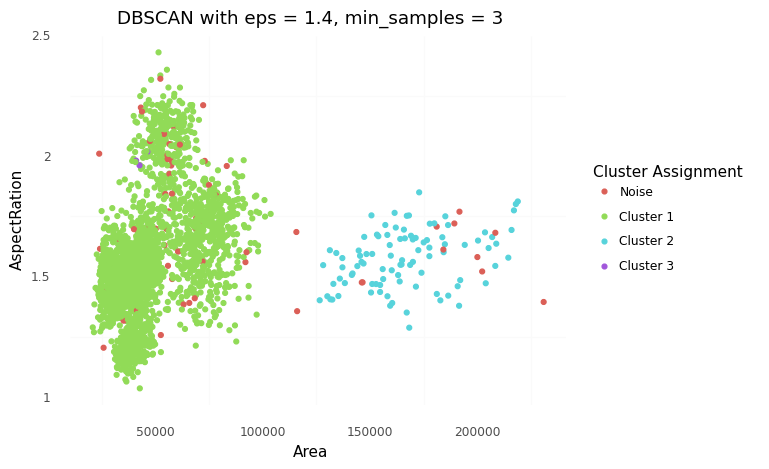

<ggplot: (124147177210)>

In [47]:
db1 = DBSCAN(eps = 1.4, min_samples =3 ).fit(data_sc)

labsList = ["Noise"]
labsList = labsList  + ["Cluster " + str(i) for i in range(1,len(set(db1.labels_)))]

dt3["assignments"] = db1.labels_

(ggplot(dt3, aes(x = 'Area', y = 'AspectRation', color = "factor(assignments)")) +
 geom_point() +
 theme_minimal() +
 scale_color_discrete(name = "Cluster Assignment",
                      labels = labsList) +
theme(panel_grid_major = element_blank()) +
labs(title = "DBSCAN with eps = 1.4, min_samples = 3"))

In [48]:
print("silhouette_score is equal : ",silhouette_score(data_sc,db1.labels_))

silhouette_score is equal :  0.24604577553926824


# GaussianMixture

In [49]:
dt4=data.copy()

In [50]:
GM = GaussianMixture(7)

In [51]:
GM.fit(data_sc)

GaussianMixture(n_components=7)

In [52]:
dt4["GM"] = GM.predict(data_sc)

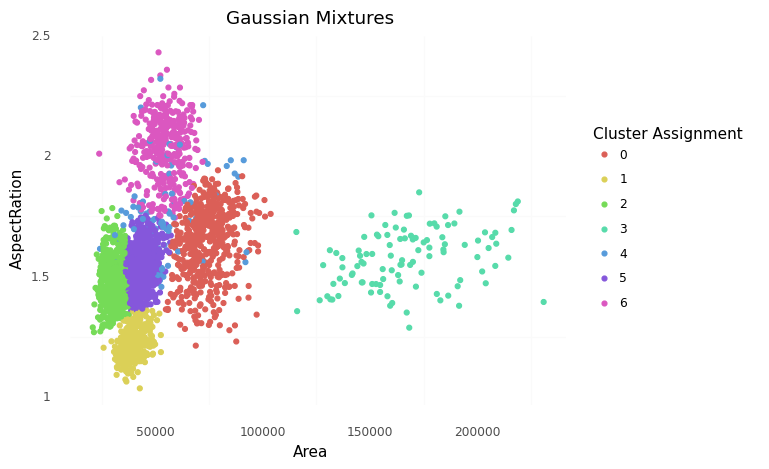

<ggplot: (124143577778)>

In [53]:
(ggplot(dt4, aes(x = 'Area', y = 'AspectRation',color = "factor(GM)")) +
 geom_point() +
 theme_minimal() +
 scale_color_discrete(name = "Cluster Assignment") +
 theme(panel_grid_major = element_blank()) + 
 labs(title = "Gaussian Mixtures"))

In [54]:
print("silhouette_score is equal : ",silhouette_score(data_sc,dt4["GM"]))

silhouette_score is equal :  0.3007935702839261
